In [1]:
%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format='retina'

import sys
sys.path.append("../")

In [2]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import scanpy as sc
import scipy

import networkx as nx

from sklearn.neighbors import KNeighborsClassifier

In [3]:
sc.settings.set_figure_params(dpi_save=1200, vector_friendly=True, fontsize=18)
plt.rcParams['axes.grid'] = False


In [4]:
from decipher_model import DecipherConfig, Decipher
from load_data import palette_original
from decipher_training import train_simple
from post_analysis import rotate_decipher_space, cluster_representations, compute_trajectories, rot, compute_decipher_time
from post_analysis_plotting import plot_decipher_v, plot_trajectory

In [5]:
adata = sc.read_h5ad("analysis/AML1.decipher.post-analyzed.h5ad")
n_genes = adata.shape[1]

cvi_config = DecipherConfig(
    seed=0,
    learning_rate=1e-3,
)
model = Decipher(
    genes_dim=n_genes,
    decipher_config=cvi_config,
)
model.load_state_dict(torch.load("data/AML1.decipher.pth"))
model.eval();


# compatibility - to do in original adata
adata.obsm["decipher_v"] = adata.obsm["latent_p"]
adata.obsm["decipher_z"] = adata.obsm["latent_z"]
adata.obs["origin"] = adata.obs["origin"].replace({"p89":"AML1", "healthy": "Healthy"})



V4


In [6]:
def simulate_from_prelatent_rotated(model, latent_p, rotation, l_scale=10_000, seed=0):
    import pyro.distributions as dist
    latent_p = latent_p @ np.linalg.inv(rotation)
    z_mean, z_scale = model.decoder_p_to_z(torch.FloatTensor(latent_p))
    z_scale = torch.nn.functional.softplus(z_scale)
    z_samples = torch.distributions.Normal(z_mean, z_scale).sample()
    gene_mean = torch.nn.functional.softmax(model.decoder_z_to_x(z_samples), dim=-1)
    
    # theta wsa not saved, resample it
    rng = np.random.default_rng(seed)
    theta = torch.tensor(rng.gamma(2., 1/2.0, gene_mean.shape))
    nb_logits = (l_scale * gene_mean + 0.005).log() - (theta + 0.005).log()
    gene_dist = dist.NegativeBinomial(
        total_count=theta, logits=nb_logits
    )
    gene_samples = gene_dist.sample().detach().numpy()
    return gene_samples, z_samples


In [7]:
def simulate_data_from_model(
    adata,
    model,
    normal_trajectory,
    perturbed_trajectory,
    downsample_cell_types=None,
    seed=0,
):
    rng = np.random.default_rng(seed)
    torch.manual_seed(seed)
    (
        simulated_normal_decipher_v,
        simulated_normal_time,
    ) = normal_trajectory.sample_uniformly(6000, 0)
    (
        simulated_perturbed_decipher_v,
        simulated_perturbed_time,
    ) = perturbed_trajectory.sample_uniformly(12000, 0)

    # get cell type of generated decipher_v
    knc = KNeighborsClassifier()
    knc.fit(adata.obsm["decipher_v_corrected"], adata.obs["cell_type_merged"])
    simulated_normal_cell_type = knc.predict(simulated_normal_decipher_v)
    simulated_perturbed_cell_type = knc.predict(simulated_perturbed_decipher_v)

    # perturb decipher_v to add noise
    simulated_normal_decipher_v = rng.normal(simulated_normal_decipher_v, 0.1)
    simulated_perturbed_decipher_v = rng.normal(simulated_perturbed_decipher_v, 0.1)

    # concatenate decipher_v/time/cell_types into a single dataset
    simulated_decipher_v = np.concatenate(
        (simulated_normal_decipher_v, simulated_perturbed_decipher_v)
    )
    simulated_time = np.concatenate((simulated_normal_time, simulated_perturbed_time))
    simulated_cell_type = np.concatenate(
        (simulated_normal_cell_type, simulated_perturbed_cell_type)
    )

    simulated_genes, simulated_latent_z = simulate_from_prelatent_rotated(
        model, simulated_decipher_v, adata.uns["decipher_rotation"]
    )

    simulated_adata = sc.AnnData(
        X=scipy.sparse.csr_matrix(simulated_genes),
        obs=pd.DataFrame(
            {
                "origin": ["simulated_healthy"] * 6000 + ["simulated_disease"] * 12000,
                "cell_type_merged": simulated_cell_type,
                "pseudo_time": simulated_time,
            },
            index=adata.obs.index,
        ),
        var=pd.DataFrame(index=adata.var.index),
    )
    simulated_adata.obsm["true_decipher_v"] = simulated_decipher_v
    simulated_adata.obs["cell_type_merged"] = pd.Categorical(
        simulated_adata.obs["cell_type_merged"]
    )

    if downsample_cell_types:
        for k in simulated_adata.obs["cell_type_merged"].cat.categories:
            if k not in downsample_cell_types:
                downsample_cell_types[k] = 1.0

        probabilities = simulated_adata.obs["cell_type_merged"].replace(
            downsample_cell_types
        )
        mask = rng.binomial(1, probabilities).astype(bool)
        simulated_adata = simulated_adata[mask]

    return simulated_adata

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


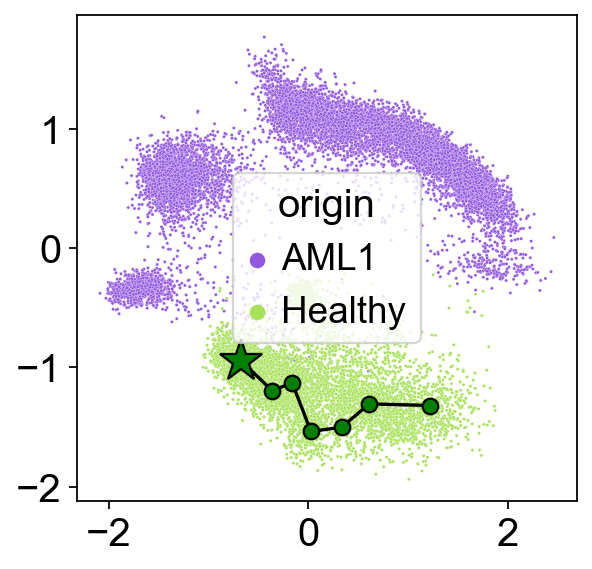

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:>

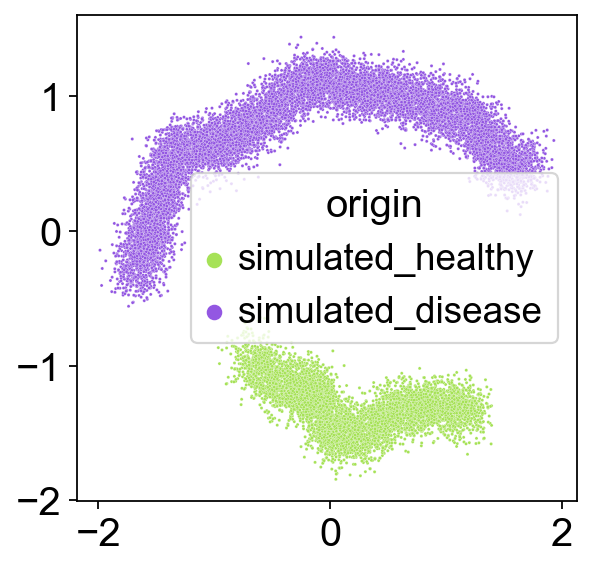

In [8]:
import pickle

with open("analysis/AML1.trajectory.normal.pkl", "rb") as f:
    normal_trajectory = pickle.load(f)

with open("analysis/AML1.trajectory.perturbed.pkl", "rb") as f:
    perturbed_trajectory = pickle.load(f)

sns.scatterplot(*adata.obsm["decipher_v_corrected"].T, hue=adata.obs["origin"], s=2, palette=palette_original)
plot_trajectory(
    adata,
    "origin=Healthy",
    color="green",
    ax=plt.gca(),
)

plt.show()

simulated_adata = simulate_data_from_model(
    adata, model, normal_trajectory, perturbed_trajectory
)
sc.pp.calculate_qc_metrics(simulated_adata, inplace=True)

palette_original["simulated_healthy"] = palette_original["Healthy"]
palette_original["simulated_disease"] = palette_original["AML1"]


sns.scatterplot(
    *simulated_adata.obsm["true_decipher_v"].T,
    hue=simulated_adata.obs["origin"],
    s=2,
    palette=palette_original
)

In [45]:
sc.write("data/simulated.AML1.h5ad", simulated_adata)

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


V4
[Epoch 0000]  Loss: 87161041.74411


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


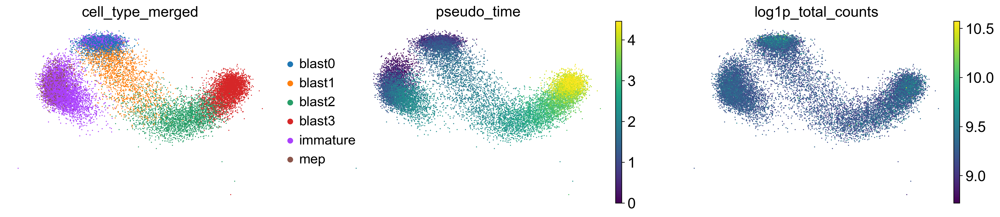

[Epoch 0001]  Loss: 77706283.24221
[Epoch 0002]  Loss: 76875858.62867
[Epoch 0003]  Loss: 76626251.78781
[Epoch 0004]  Loss: 76475305.41737
[Epoch 0005]  Loss: 76420586.10954


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


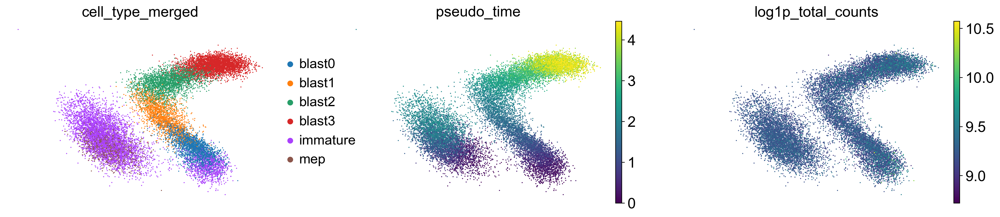

[Epoch 0006]  Loss: 76441447.84563
[Epoch 0007]  Loss: 76338609.59345
[Epoch 0008]  Loss: 76364832.94059
[Epoch 0009]  Loss: 76323244.66616
[Epoch 0010]  Loss: 76294256.12054


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


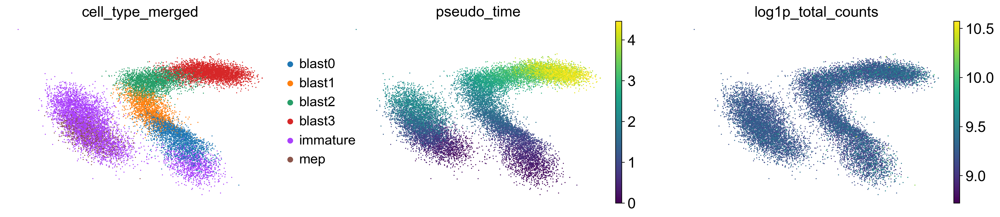

[Epoch 0011]  Loss: 76349112.51503
[Epoch 0012]  Loss: 76280247.44451
[Epoch 0013]  Loss: 76284046.40580
[Epoch 0014]  Loss: 76257232.90334
[Epoch 0015]  Loss: 76270177.87868


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


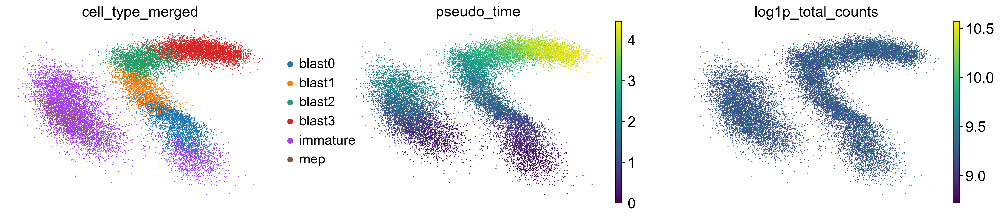

[Epoch 0016]  Loss: 76225337.40449
[Epoch 0017]  Loss: 76236640.87797
[Epoch 0018]  Loss: 76238488.74905
[Epoch 0019]  Loss: 76230530.75500
[Epoch 0020]  Loss: 76230374.98177


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


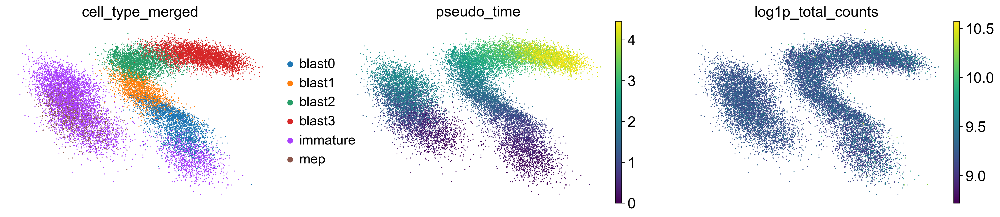

[Epoch 0021]  Loss: 76212716.17094
[Epoch 0022]  Loss: 76257196.42269
[Epoch 0023]  Loss: 76216238.40633
[Epoch 0024]  Loss: 76214003.72811
[Epoch 0025]  Loss: 76208725.32403


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


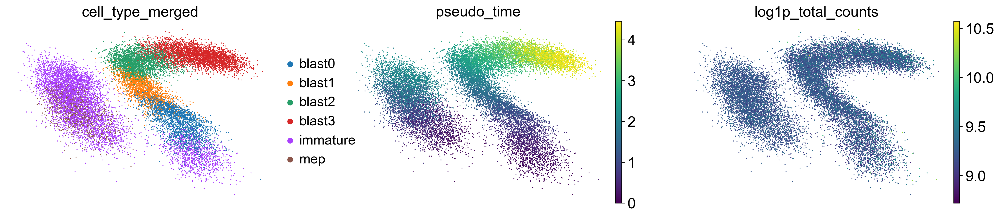

In [44]:
correlations = []
seed = 0
batch_size = 256
learning_rate = 1e-2

decipher_config = DecipherConfig(
    latent_dim=10,
    pre_latent_dim=2,
    scale_factor=float(np.round(simulated_adata.shape[0] / batch_size, 3)),
    prior="normal",
    z_to_x_layers=[],
    seed=0,
    learning_rate=learning_rate,
    context=[],
    beta=0.1,
)
simulated_model = train_simple(
    simulated_adata,
    decipher_config,
    learning_rate,
    batch_size=batch_size,
    plot_every_k_epoch=5,
    plot_kwargs=dict(
        color=["cell_type_merged", "pseudo_time", "log1p_total_counts"]
    ),
    n_epochs=26,
)


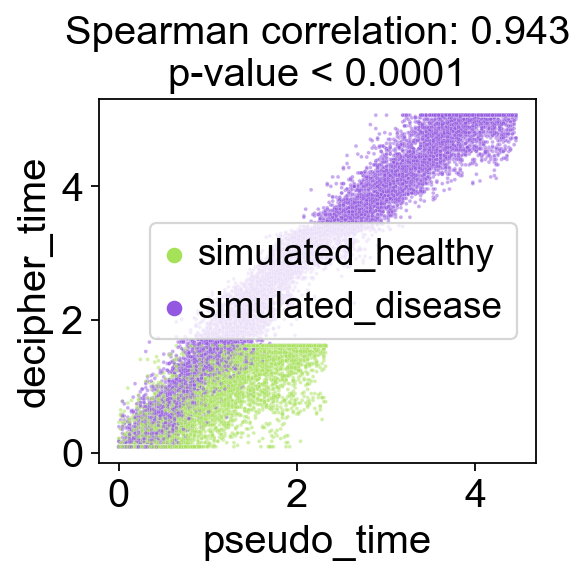

In [10]:

# rotate space
simulated_adata.obs["origin_int"] = simulated_adata.obs["origin"].replace(
    {"simulated_disease": 1, "simulated_healthy": 0}
)
rotate_decipher_space(
    simulated_adata,
    "origin_int",
    decipher_component_to_align_label_with=2,
    flip_latent_z=True,
    flip_decipher_1=True,
)

cluster_representations(simulated_adata)
normal_trajectory = compute_trajectories(
    simulated_adata,
    "AVP",
    "MPO",
    subset_column="origin",
    subset_value="simulated_healthy",
    cell_types_key="cell_type_merged",
)
perturbed_trajectory = compute_trajectories(
    simulated_adata,
    "AVP",
    "CD68",
    subset_column="origin",
    subset_value="simulated_disease",
    cell_types_key="cell_type_merged",
)
compute_decipher_time(
    simulated_adata,
    dict(
        simulated_healthy=normal_trajectory, simulated_disease=perturbed_trajectory
    ),
)
with plt.rc_context({"figure.figsize": [3.5, 3]}):
    sns.scatterplot(
        data=simulated_adata.obs.sample(frac=0.99, random_state=0),
        x="pseudo_time",
        y="decipher_time",
        hue="origin",
        s=3,
        alpha=0.5,
        palette=palette_original,
    )
    ax = plt.gca()
    ax.legend(title="")
    ax.set_title(
        "Spearman correlation: %.3f\np-value < 0.0001"
        % scipy.stats.spearmanr(
            simulated_adata.obs["pseudo_time"],
            simulated_adata.obs["decipher_time"],
        ).correlation
    )

    plt.show()

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical
/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


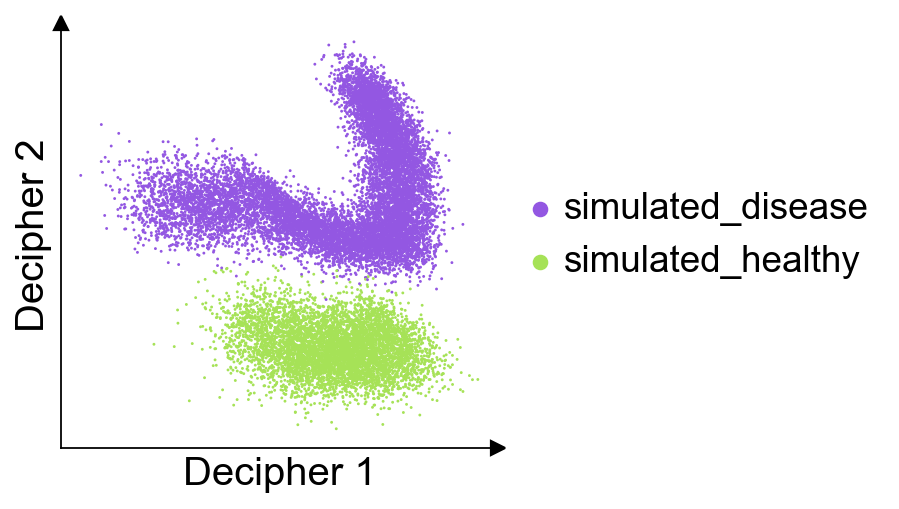

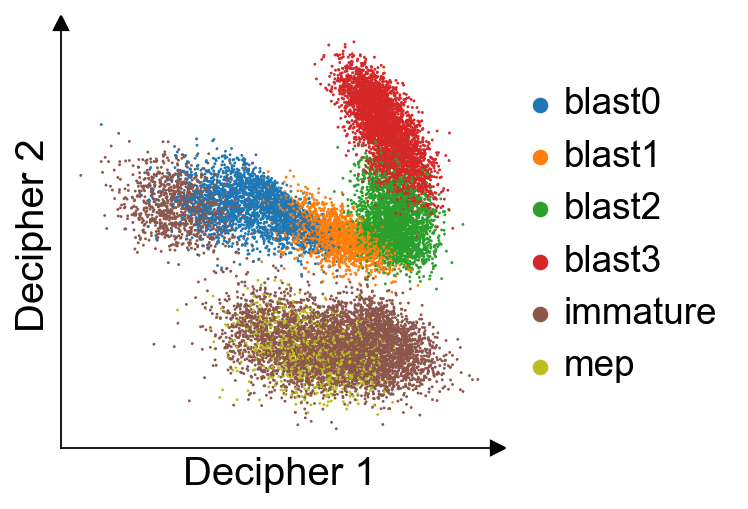

In [25]:
plot_decipher_v(simulated_adata, "origin", palette=palette_original, basis="decipher_v_corrected")
plt.savefig("figures/figure1/simulated.decipher_space.origin.pdf", bbox_inches="tight")
plot_decipher_v(simulated_adata, "cell_type_merged", palette=palette_original, basis="decipher_v_corrected")
plt.savefig("figures/figure1/simulated.decipher_space.cell_type.pdf", bbox_inches="tight")


plot_decipher_v(
    simulated_adata,
    "decipher_time",
    palette=palette_original,
    basis="decipher_v_corrected",
    title="Decipher time",
)
plt.savefig(
    "figures/figure1/simulated.decipher_space.decipher_time.pdf", bbox_inches="tight"
)

with plt.rc_context({"figure.figsize": [3.5, 3]}):
    plt.figure()
    sns.scatterplot(
        data=simulated_adata.obs.sample(frac=0.99, random_state=0),
        x="pseudo_time",
        y="decipher_time",
        hue="origin",
        s=1,
#         alpha=0.5,
        palette=palette_original,
        edgecolor=None,
    )
    ax = plt.gca()
    
    ax.legend([],[], frameon=False)
    ax.set_title(
        "Spearman correlation: %.3f\np-value < 0.0001"
        % scipy.stats.spearmanr(
            simulated_adata.obs["pseudo_time"],
            simulated_adata.obs["decipher_time"],
        ).correlation
    )
    ax.set_xlabel("True simulated time")
    ax.set_ylabel("Decipher time")
plt.savefig("figures/figure1/simulated.decipher_time.correlation.pdf", bbox_inches="tight")

In [30]:
from post_analysis_plotting import plot_decipher_v

In [14]:
simulated_adata = sc.read_h5ad("analysis/SIMULATED.AML1.decipher.post-analyzed.h5ad")

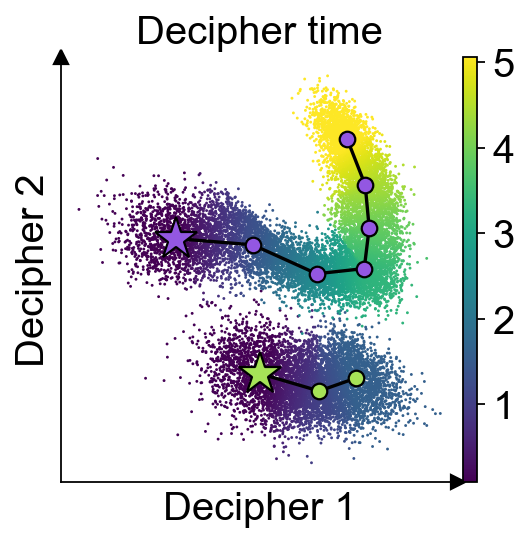

In [16]:
plot_decipher_v(
    simulated_adata,
    "decipher_time",
    palette=palette_original,
    basis="decipher_v_corrected",
    title="Decipher time",
)
for k in ["simulated_healthy", "simulated_disease"]:
    plot_trajectory(
        simulated_adata,
        f"origin={k}",
        palette_original[k],
        plt.gca(),
    )
plt.savefig(
    "figures/extended_figure2/simulated.decipher_space.decipher_time.pdf", bbox_inches="tight"
)

In [17]:
len(simulated_adata)

18000

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


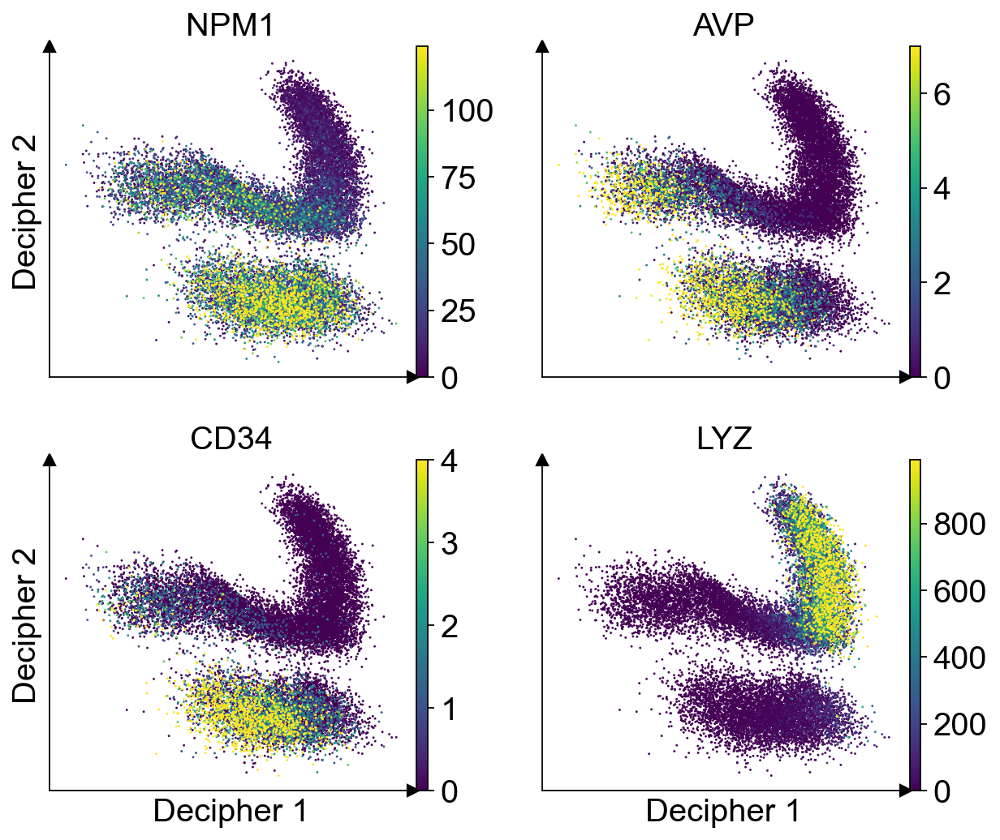

In [41]:
plot_decipher_v(
    simulated_adata,
    ["NPM1", "AVP", "CD34", "LYZ"],
    palette=palette_original,
    basis="decipher_v_corrected",
    vmax=lambda x: np.quantile(x, 0.95),
    ncols=2,
    ax_label_only_on_edges=True,
)
plt.savefig("figures/figure1/simulated.gene_expression.pdf", bbox_inches="tight")

In [12]:
sc.write("analysis/SIMULATED.AML1.decipher.post-analyzed.h5ad", simulated_adata)

Only considering the two last: ['.post-analyzed', '.h5ad'].
Only considering the two last: ['.post-analyzed', '.h5ad'].


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


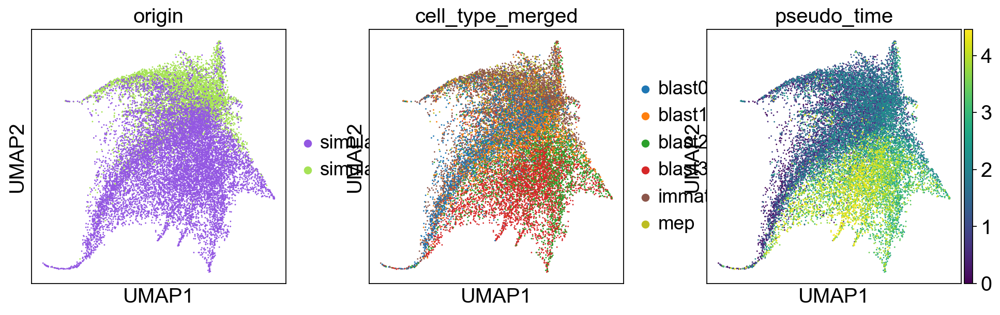

In [14]:
sc.pp.pca(simulated_adata)
sc.pp.neighbors(simulated_adata, use_rep="X_pca")
sc.tl.umap(simulated_adata)

sc.pl.umap(
    simulated_adata,
    color=["origin", "cell_type_merged", "pseudo_time"],
    palette=palette_original,
)

In [15]:
sc.pp.neighbors(simulated_adata, use_rep="X_pca")
sc.tl.umap(adata)

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


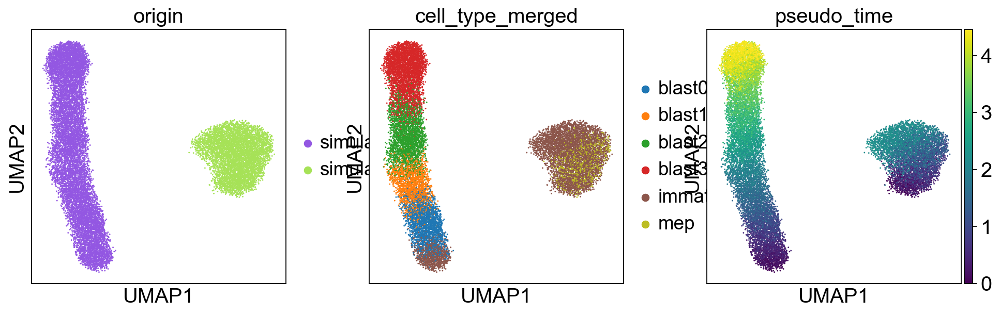

<Figure size 320x320 with 0 Axes>

In [12]:
simulated_adata_log = sc.pp.log1p(simulated_adata, copy=True)
sc.pp.pca(simulated_adata_log, n_comps=50)
sc.pp.neighbors(simulated_adata_log, use_rep="X_pca")
sc.tl.umap(simulated_adata_log)

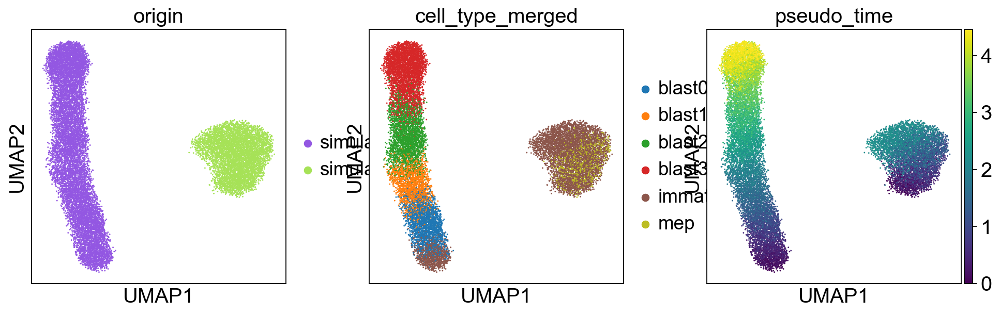

In [13]:
sc.pl.umap(
    simulated_adata_log,
    color=["origin", "cell_type_merged", "pseudo_time"],
    palette=palette_original,
    show=False,
)
plt.savefig("./figures/extended_figure2/simulation.AML1.umap.pdf", bbox_inches="tight")

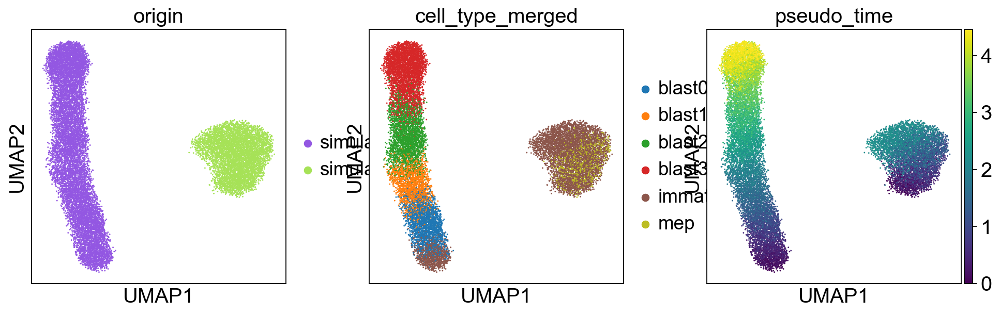

In [18]:
simulated_adata_log = sc.pp.log1p(simulated_adata, copy=True)
sc.pp.pca(simulated_adata_log)
sc.pp.neighbors(simulated_adata_log, use_rep="X_pca")
sc.tl.umap(simulated_adata_log)

sc.pl.umap(
    simulated_adata_log,
    color=["origin", "cell_type_merged", "pseudo_time"],
    palette=palette_original,
)

# Simulation with downsampling

/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


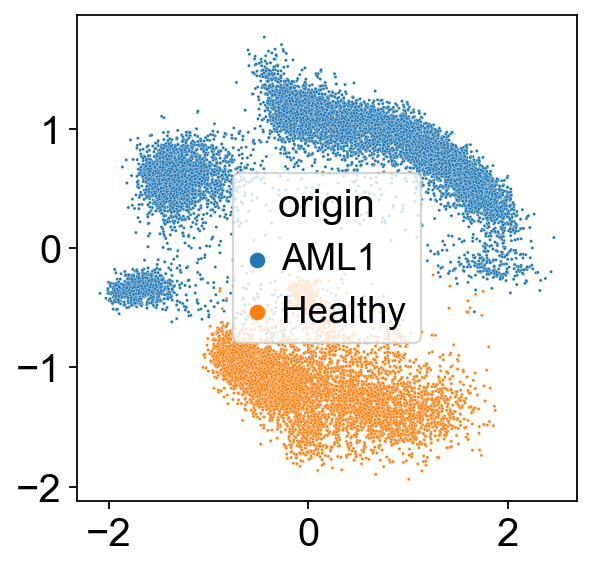

Trying to set attribute `.obs` of view, copying.
/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:>

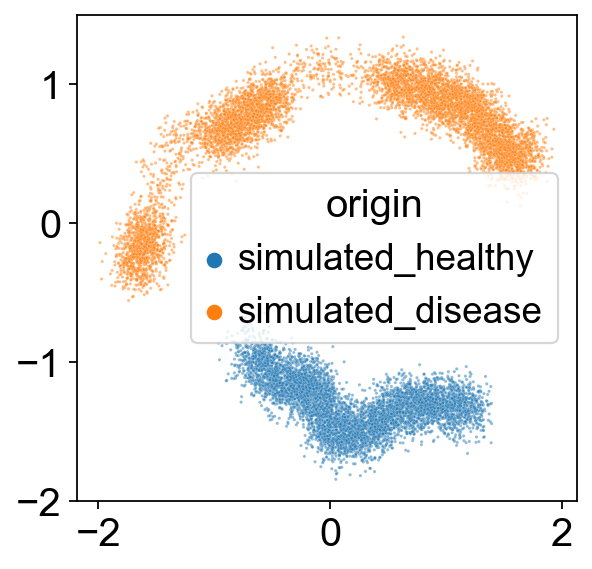

In [8]:
import pickle

with open("analysis/AML1.trajectory.normal.pkl", "rb") as f:
    normal_trajectory = pickle.load(f)

with open("analysis/AML1.trajectory.perturbed.pkl", "rb") as f:
    perturbed_trajectory = pickle.load(f)

sns.scatterplot(*adata.obsm["decipher_v_corrected"].T, hue=adata.obs["origin"], s=2)
# plot_trajectory(
#     plt.gca(),
#     normal_trajectory,
# )
plt.show()

simulated_adata = simulate_data_from_model(
    adata,
    model,
    normal_trajectory,
    perturbed_trajectory,
    dict(blast0=0.1, blast2=0.1),
    
)
sc.pp.calculate_qc_metrics(simulated_adata, inplace=True)

palette_original["simulated_healthy"] = palette_original["Healthy"]
palette_original["simulated_disease"] = palette_original["AML1"]


sns.scatterplot(
    *simulated_adata.obsm["true_decipher_v"].T, hue=simulated_adata.obs["origin"], s=2, alpha=0.5
)

V4
[Epoch 0000]  Loss: 66707998.83100


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


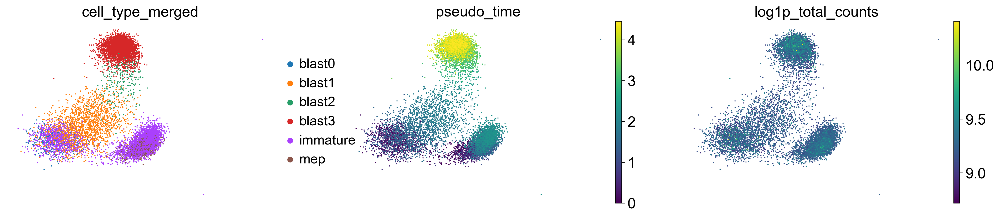

[Epoch 0001]  Loss: 57358206.64605
[Epoch 0002]  Loss: 56651361.51356
[Epoch 0003]  Loss: 56513225.15767
[Epoch 0004]  Loss: 56471587.65528
[Epoch 0005]  Loss: 56277700.96888


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


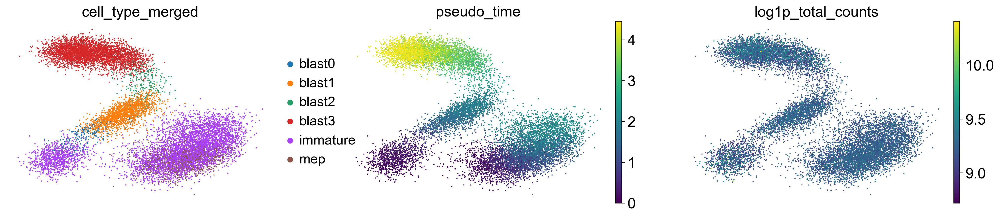

[Epoch 0006]  Loss: 56237246.44198
[Epoch 0007]  Loss: 56208328.60447
[Epoch 0008]  Loss: 56173129.96176
[Epoch 0009]  Loss: 56145672.11429
[Epoch 0010]  Loss: 56155337.71754


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


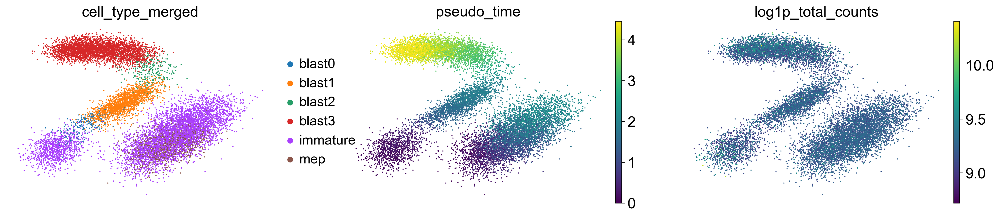

[Epoch 0011]  Loss: 56115180.75267
[Epoch 0012]  Loss: 56110312.40362
[Epoch 0013]  Loss: 56091168.90434
[Epoch 0014]  Loss: 56186053.98333
[Epoch 0015]  Loss: 56096361.79629


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


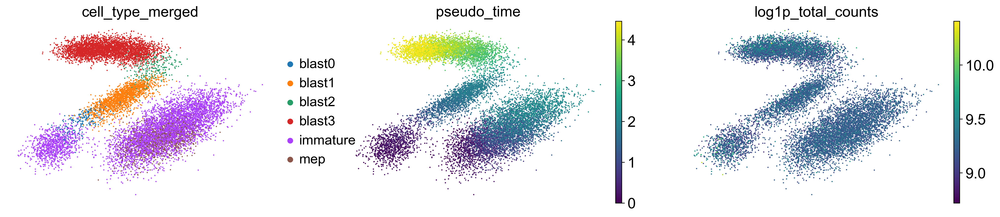

[Epoch 0016]  Loss: 56073099.51809
[Epoch 0017]  Loss: 56067505.38163
[Epoch 0018]  Loss: 56075486.57469
[Epoch 0019]  Loss: 56063234.68281
[Epoch 0020]  Loss: 56102085.51588


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


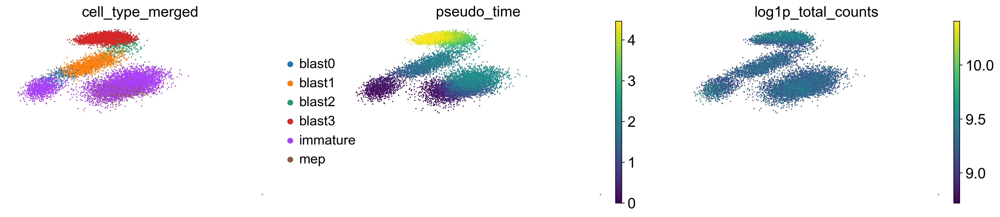

[Epoch 0021]  Loss: 56145019.35624
[Epoch 0022]  Loss: 56085569.06063
[Epoch 0023]  Loss: 56052495.78606
[Epoch 0024]  Loss: 56049418.37158
[Epoch 0025]  Loss: 56061808.67458


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


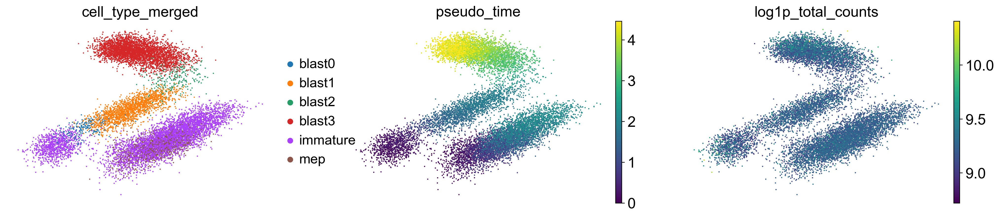

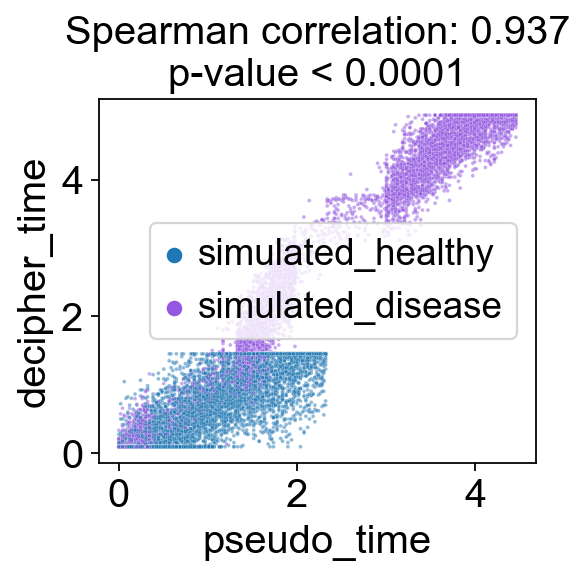

In [9]:
correlations = []
seed = 0
batch_size = 256
learning_rate = 1e-2

for i in range(1):
    decipher_config = DecipherConfig(
        latent_dim=10,
        pre_latent_dim=2,
        scale_factor=float(np.round(simulated_adata.shape[0] / batch_size, 3)),
        prior="normal",
        z_to_x_layers=[],
        seed=i,
        learning_rate=learning_rate,
        context=[],
        beta=0.1,
    )
    simulated_model = train_simple(
        simulated_adata,
        decipher_config,
        learning_rate,
        batch_size=batch_size,
        plot_every_k_epoch=5,
        plot_kwargs=dict(
            color=["cell_type_merged", "pseudo_time", "log1p_total_counts"]
        ),
        n_epochs=26,
    )

    # rotate space
    simulated_adata.obs["origin_int"] = simulated_adata.obs["origin"].replace(
        {"simulated_disease": 1, "simulated_healthy": 0}
    )
    rotate_decipher_space(
        simulated_adata,
        "origin_int",
        decipher_component_to_align_label_with=2,
        flip_latent_z=True,
    )

    # compute trajectories
#     mask = (
#         (
#             simulated_adata.obsm["decipher_v_corrected"]
#             >= np.quantile(simulated_adata.obsm["decipher_v_corrected"], 0.001, axis=0)
#         ).sum(axis=1)
#         == 2
#     ) & (
#         (
#             simulated_adata.obsm["decipher_v_corrected"]
#             <= np.quantile(simulated_adata.obsm["decipher_v_corrected"], 0.999, axis=0)
#         ).sum(axis=1)
#         == 2
#     )
#     simulated_adata = simulated_adata[mask]

    cluster_representations(simulated_adata)
    normal_trajectory = compute_trajectories(
        simulated_adata,
        "AVP",
        "MPO",
        subset_column="origin",
        subset_value="simulated_healthy",
        cell_types_key="cell_type_merged",
    )
    perturbed_trajectory = compute_trajectories(
        simulated_adata,
        "AVP",
        "CD68",
        subset_column="origin",
        subset_value="simulated_disease",
        cell_types_key="cell_type_merged",
    )
    compute_decipher_time(
        simulated_adata,
        dict(
            simulated_healthy=normal_trajectory, simulated_disease=perturbed_trajectory
        ),
    )
    with plt.rc_context({"figure.figsize": [3.5, 3]}):
        sns.scatterplot(
            data=simulated_adata.obs.sample(frac=0.99, random_state=0),
            x="pseudo_time",
            y="decipher_time",
            hue="origin",
            s=3,
            alpha=0.5,
            palette=palette_original,
        )
        plt.gca().legend(title="")
        plt.gca().set_title(
            "Spearman correlation: %.3f\np-value < 0.0001"
            % scipy.stats.spearmanr(
                simulated_adata.obs["pseudo_time"],
                simulated_adata.obs["decipher_time"],
            ).correlation
        )
        plt.show()

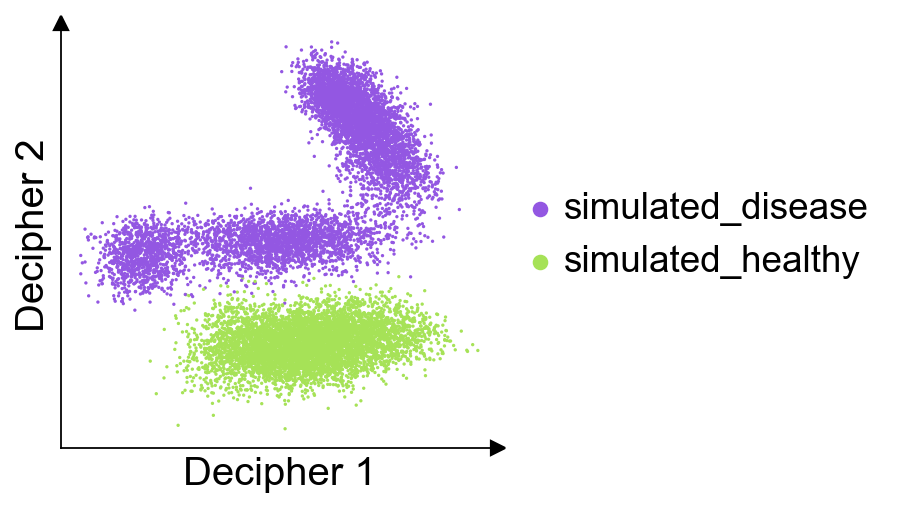

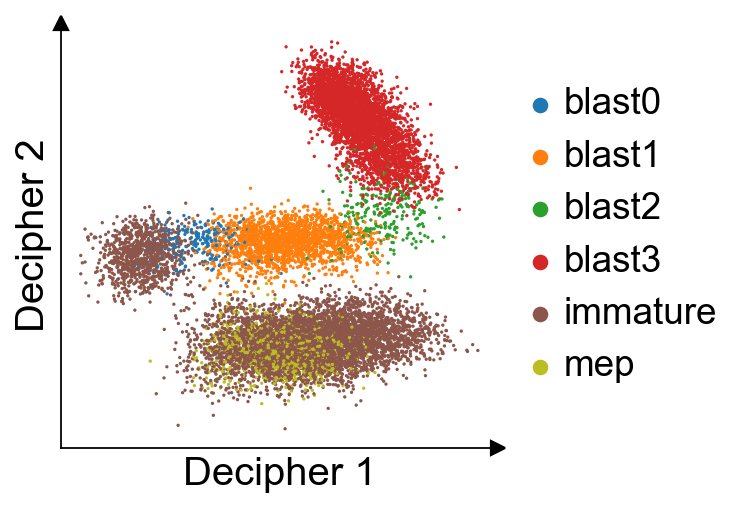

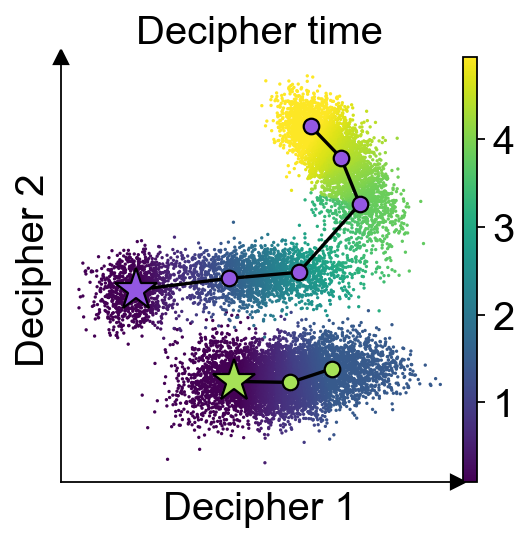

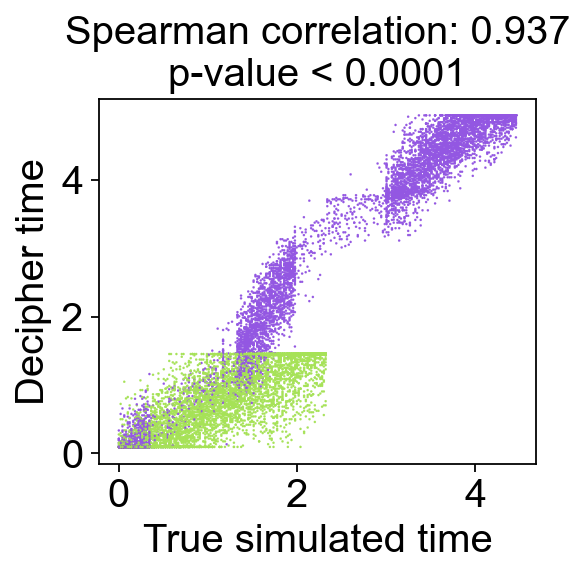

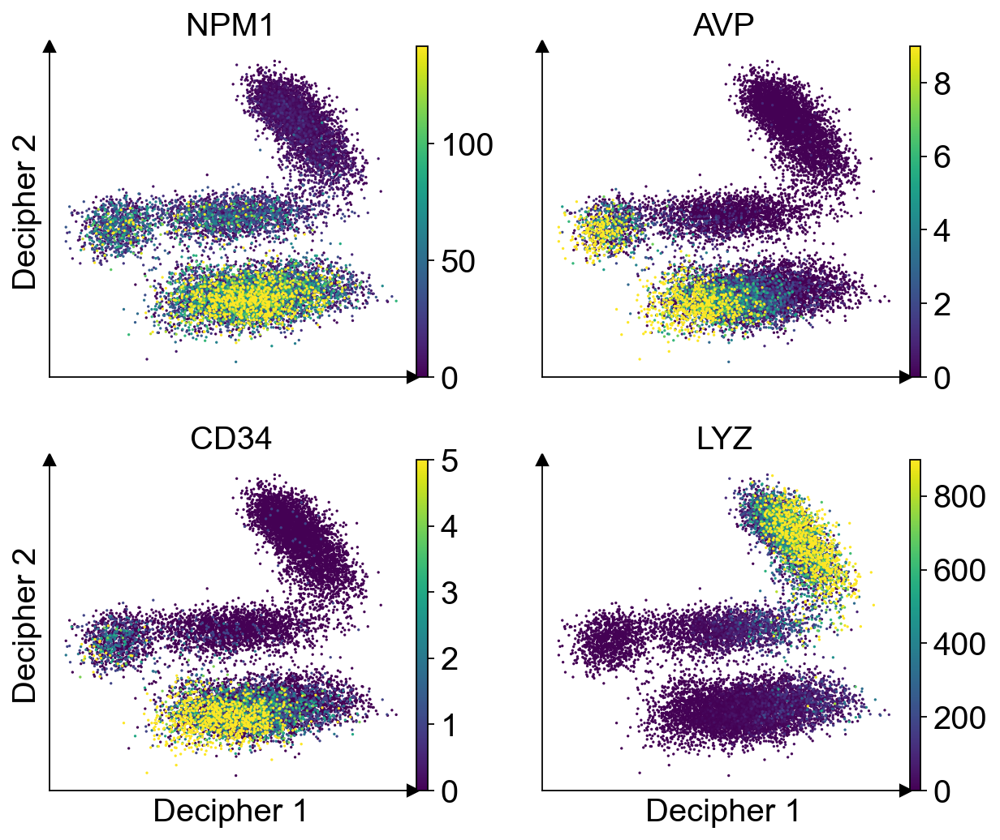

In [29]:
plot_decipher_v(simulated_adata, "origin", palette=palette_original, basis="decipher_v_corrected")
plt.savefig("figures/extended_figure1/simulated.downsampled.decipher_space.origin.pdf", bbox_inches="tight")
plot_decipher_v(simulated_adata, "cell_type_merged", palette=palette_original, basis="decipher_v_corrected")
plt.savefig("figures/extended_figure1/simulated.downsampled.decipher_space.cell_type.pdf", bbox_inches="tight")


plot_decipher_v(
    simulated_adata,
    "decipher_time",
    palette=palette_original,
    basis="decipher_v_corrected",
    title="Decipher time",
)
for k in ["simulated_healthy", "simulated_disease"]:
    plot_trajectory(
        simulated_adata,
        f"origin={k}",
        palette_original[k],
        plt.gca(),
    )
plt.savefig(
    "figures/extended_figure1/simulated.downsampled.decipher_space.decipher_time.pdf", bbox_inches="tight"
)


with plt.rc_context({"figure.figsize": [3.5, 3]}):
    plt.figure()
    sns.scatterplot(
        data=simulated_adata.obs.sample(frac=0.99, random_state=0),
        x="pseudo_time",
        y="decipher_time",
        hue="origin",
        s=1,
#         alpha=0.5,
        palette=palette_original,
        edgecolor=None,
    )
    ax = plt.gca()
    
    ax.legend([],[], frameon=False)
    ax.set_title(
        "Spearman correlation: %.3f\np-value < 0.0001"
        % scipy.stats.spearmanr(
            simulated_adata.obs["pseudo_time"],
            simulated_adata.obs["decipher_time"],
        ).correlation
    )
    ax.set_xlabel("True simulated time")
    ax.set_ylabel("Decipher time")
plt.savefig("figures/extended_figure1/simulated.downsampled.decipher_time.correlation.pdf", bbox_inches="tight")

plot_decipher_v(
    simulated_adata,
    ["NPM1", "AVP", "CD34", "LYZ"],
    palette=palette_original,
    basis="decipher_v_corrected",
    vmax=lambda x: np.quantile(x, 0.95),
    ncols=2,
    ax_label_only_on_edges=True,
)
plt.savefig("figures/extended_figure1/simulated.downsampled.gene_expression.pdf", bbox_inches="tight")

In [ ]:
simulated_adata_log = sc.pp.log1p(simulated_adata, copy=True)
sc.pp.pca(simulated_adata_log)
sc.pp.neighbors(simulated_adata_log, use_rep="X_pca")
sc.tl.umap(simulated_adata_log)


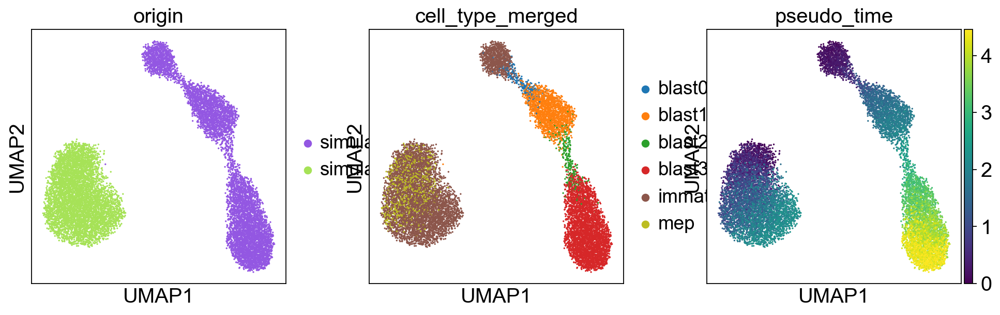

In [31]:
sc.pl.umap(
    simulated_adata_log,
    color=["origin", "cell_type_merged", "pseudo_time"],
    palette=palette_original,
    show=False,
)
plt.savefig("figures/extended_figure1/simulated.downsampled.umap.pdf", bbox_inches="tight")

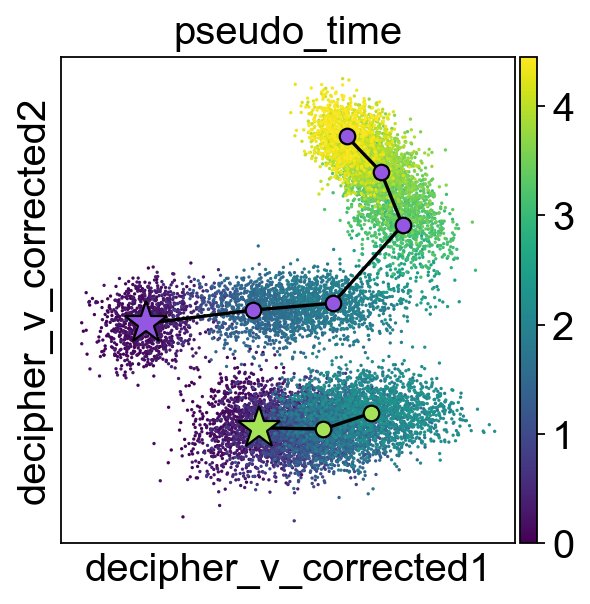

In [21]:
fig = sc.pl.embedding(simulated_adata, "decipher_v_corrected", color="pseudo_time", show=False, return_fig=True)

for k in ["simulated_healthy", "simulated_disease"]:
    plot_trajectory(
        simulated_adata,
        f"origin={k}",
        palette_original[k],
        fig.axes[0],
    )


In [53]:
sc.write("./data/simulated.AML1.downsampled.h5ad", simulated_adata)

Only considering the two last: ['.downsampled', '.h5ad'].
Only considering the two last: ['.downsampled', '.h5ad'].


/opt/miniconda3/envs/latent-manifold/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'origin' as categorical


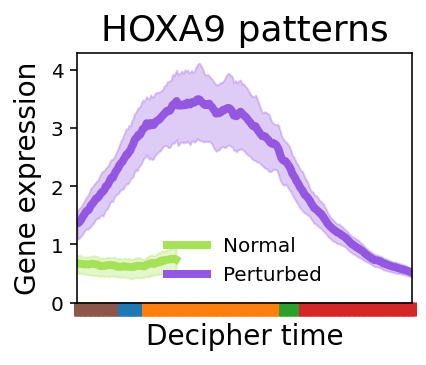

In [151]:
plot_gene_patterns_normal_perturbed(
    "HOXA9",
    crop_to_equal_length=False,
)